## Embarassingly simple MIT

In [1]:
import anndata
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
from torchvision.transforms import RandomResizedCrop, Compose, RandomHorizontalFlip, RandomVerticalFlip, Resize

from torch.utils.data import DataLoader
from tqdm import tqdm
from functools import partial
from typing import Optional, Tuple, Type, Dict, List

from utils import DatasetFromTIFF, plot_markers, get_marker_names_map, window_partition, window_unpartition

In [2]:
import json

marker_map = json.load(open('tokenizer_vocab.json'))
markers_names_map = {v: k for k, v in marker_map.items()}

In [3]:
# code from https://github.com/naver-ai/rope-vit/blob/main/self-attn/rope_self_attn.py

def init_2d_freqs(dim: int, num_heads: int, theta: float = 10.0, rotate: bool = True):
    freqs_x = []
    freqs_y = []
    mag = 1 / (theta ** (torch.arange(0, dim, 4)[: (dim // 4)].float() / dim))
    for i in range(num_heads):
        angles = torch.rand(1) * 2 * torch.pi if rotate else torch.zeros(1)        
        fx = torch.cat([mag * torch.cos(angles), mag * torch.cos(torch.pi/2 + angles)], dim=-1)
        fy = torch.cat([mag * torch.sin(angles), mag * torch.sin(torch.pi/2 + angles)], dim=-1)
        freqs_x.append(fx)
        freqs_y.append(fy)
    freqs_x = torch.stack(freqs_x, dim=0)
    freqs_y = torch.stack(freqs_y, dim=0)
    freqs = torch.stack([freqs_x, freqs_y], dim=0)
    return freqs

def init_t_xy(end_x: int, end_y: int):
    t = torch.arange(end_x * end_y, dtype=torch.float32)
    t_x = (t % end_x).float()
    t_y = torch.div(t, end_x, rounding_mode='floor').float()
    return t_x, t_y

def compute_mixed_cis(freqs: torch.Tensor, t_x: torch.Tensor, t_y: torch.Tensor, num_heads: int):
    N = t_x.shape[0]
    # No float 16 for this range
    # with torch.amp.autocast(freqs.device, enabled=False):
    freqs_x = (t_x.unsqueeze(-1) @ freqs[0].unsqueeze(-2)).view(N, num_heads, -1).permute(1, 0, 2)
    freqs_y = (t_y.unsqueeze(-1) @ freqs[1].unsqueeze(-2)).view(N, num_heads, -1).permute(1, 0, 2)
    freqs_cis = torch.polar(torch.ones_like(freqs_x), freqs_x + freqs_y)
    return freqs_cis

def reshape_for_broadcast(freqs_cis: torch.Tensor, x: torch.Tensor):
    ndim = x.ndim
    assert 1 < ndim
    if freqs_cis.shape == (x.shape[-2], x.shape[-1]):
        shape = [d if i >= ndim-2 else 1 for i, d in enumerate(x.shape)]

    elif freqs_cis.shape == (x.shape[-3], x.shape[-2], x.shape[-1]):
        shape = [d if i >= ndim-3 else 1 for i, d in enumerate(x.shape)]

    return freqs_cis.view(*shape)

def apply_rotary_emb(xq: torch.Tensor, xk: torch.Tensor, freqs_cis: torch.Tensor):
    xq_ = torch.view_as_complex(xq.float().reshape(*xq.shape[:-1], -1, 2))
    xk_ = torch.view_as_complex(xk.float().reshape(*xk.shape[:-1], -1, 2))
    freqs_cis = reshape_for_broadcast(freqs_cis, xq_)
    xq_out = torch.view_as_real(xq_ * freqs_cis).flatten(3)
    xk_out = torch.view_as_real(xk_ * freqs_cis).flatten(3)
    return xq_out.type_as(xq).to(xq.device), xk_out.type_as(xk).to(xk.device)





In [4]:
class LayerNorm2d(nn.Module):
    """Layer normalization for 2D data from 
    https://github.com/facebookresearch/segment-anything/blob/main/segment_anything/modeling/common.py"""
    def __init__(self, num_channels: int, eps: float = 1e-6) -> None:
        super().__init__()
        self.weight = nn.Parameter(torch.ones(num_channels))
        self.bias = nn.Parameter(torch.zeros(num_channels))
        self.eps = eps

    def forward(self, x: torch.Tensor) -> torch.Tensor:
        u = x.mean(1, keepdim=True)
        s = (x - u).pow(2).mean(1, keepdim=True)
        x = (x - u) / torch.sqrt(s + self.eps)
        x = self.weight[:, None, None] * x + self.bias[:, None, None]
        return x


class GlobalResponseNormalization(nn.Module):
    """Global Response Normalization (GRN) layer 
    from https://arxiv.org/pdf/2301.00808"""

    def __init__(self, dim, eps: float = 1e-6):
        super().__init__()
        self.eps = eps

        self.gamma = nn.Parameter(torch.zeros(1, 1, 1, dim))
        self.beta = nn.Parameter(torch.zeros(1, 1, 1, dim))

    def forward(self, x: torch.Tensor) -> torch.Tensor:
        # B, H, W, E = x.shape

        gx = torch.norm(x, p=2, dim=(1,2), keepdim=True)
        nx = gx / (gx.mean(dim=-1, keepdim=True) + self.eps)
        return self.gamma * (x * nx) + self.beta + x


class ConvNextBlock(nn.Module):
    """ConvNext2 block"""
    def __init__(
            self,
            dim: int,
            inter_dim: int,
    ):
            super().__init__()
            self.conv1 = nn.Conv2d(dim, dim, kernel_size=7, padding=3, groups=dim)
            self.ln = nn.LayerNorm(dim)
            self.conv2 = nn.Linear(dim, inter_dim) # equivalent to nn.Conv2d(dim, inter_dim, kernel_size=1)
            self.act = nn.GELU()
            self.grn = GlobalResponseNormalization(inter_dim)
            self.conv3 = nn.Linear(inter_dim, dim) # equivalent to nn.Conv2d(inter_dim, dim, kernel_size=1)

    def forward(self, x: torch.Tensor) -> torch.Tensor:
        # B, C, H, W = x.shape
        residual = x
        x = self.conv1(x)
        x = x.permute(0, 2, 3, 1)  # [B, H, W, C]
        x = self.ln(x)
        x = self.conv2(x)
        x = self.act(x)
        x = self.grn(x)
        x = self.conv3(x)
        x = x.permute(0, 3, 1, 2) # [B, C, H, W]
        x = x + residual

        return x


class MLP(nn.Module):
    """Standard MLP module"""
    def __init__(
            self, 
            embedding_dim: int,
            mlp_dim: int,
            mlp_bias: bool = True,
            act: Type[nn.Module] = nn.GELU,
            dropout: float = 0.2
    ) -> None:
        super().__init__()
        self.mlp = nn.Sequential(
            nn.Linear(embedding_dim, mlp_dim, bias=mlp_bias),
            act(),
            nn.Dropout(dropout),
            nn.Linear(mlp_dim, embedding_dim, bias=mlp_bias),
        )

    def forward(self, x: torch.Tensor) -> torch.Tensor:
        return self.mlp(x)


class ConvNextBlocks(nn.Module):
    """Spatial convolutional blocks (per channel/marker)"""

    def __init__(
        self,
        embedding_dim: int,
        num_blocks: int = 1,
    ) -> None:
        """
        Args:
            dim (int): Number of input channels.
            num_blocks (int): Number of spatial convolutional blocks.
        """
        super().__init__()

        self.spatial_conv_blocks = nn.ModuleList()
        for _ in range(num_blocks):
            self.spatial_conv_blocks.append(
                ConvNextBlock(
                    dim=embedding_dim,
                    inter_dim=embedding_dim*4,
                )
            )

    def forward(self, x: torch.Tensor) -> torch.Tensor:
        # B, C, H, W  = x.shape

        # Spatial convolutional blocks
        for block in self.spatial_conv_blocks:
            x = block(x)

        return x



# code adapted from https://github.com/facebookresearch/segment-anything/blob/main/segment_anything/modeling/image_encoder.py
# and https://github.com/facebookresearch/detectron2/blob/main/detectron2/modeling/backbone/vit.py
class SelfAttention(nn.Module):
    """Multi-head Attention block with ROPE relative position embeddings (per channel/marker)."""

    def __init__(
        self,
        embedding_dim: int = 768,
        num_heads: int = 8,
        qkv_bias: bool = True,
        rope_theta: float = 10.,
        input_size: Optional[Tuple[int, int]] = None,
    ) -> None:
        """
        Args:
            dim (int): Number of input channels.
            num_heads (int): Number of attention heads.
            qkv_bias (bool):  If True, add a learnable bias to query, key, value.
            rope_theta (float): Theta value for relative positional embeddings.
            input_size (tuple(int, int) or None): Input resolution for calculating the relative
                positional parameter size. If None, use the default value of 16x16 and will be adjusted
                to the input shape.
        """
        super().__init__()
        self.num_heads = num_heads
        head_dim = embedding_dim // num_heads
        self.scale = head_dim**-0.5

        self.qkv = nn.Linear(embedding_dim, embedding_dim * 3, bias=qkv_bias)


        # self.relative_pos_emb = RelativePositionEmbedding(num_heads=num_heads)

        self.compute_cis = partial(compute_mixed_cis, num_heads=self.num_heads)
            
        freqs = init_2d_freqs(
            dim=head_dim, num_heads=self.num_heads, theta=rope_theta, 
            rotate=True
        ).view(2, -1)
        self.freqs = nn.Parameter(freqs, requires_grad=True)
        
        if input_size is not None:
            end_x, end_y = input_size
        else:
            end_x, end_y = 16, 16

        t_x, t_y = init_t_xy(end_x=end_x, end_y=end_y)
        self.register_buffer('freqs_t_x', t_x)
        self.register_buffer('freqs_t_y', t_y)


    def forward(self, x: torch.Tensor) -> torch.Tensor:
        B, H, W, _ = x.shape
        # qkv with shape (3, B, nHead, H * W, C)
        qkv = self.qkv(x).reshape(B, H * W, 3, self.num_heads, -1).permute(2, 0, 3, 1, 4)

        # q, k, v with shape (B, nHead, H * W, C)
        q, k, v = qkv.unbind(0)

        # Apply rotary embeddings
        # t_x, t_y = self.freqs_t_x, self.freqs_t_y
        
        # if self.freqs_t_x.shape[0] != H:
        #     t_x, t_y = init_t_xy(end_x=W, end_y=H)
        #     t_x, t_y = t_x.to(x.device), t_y.to(x.device)
        # freqs_cis = self.compute_cis(self.freqs, t_x, t_y)

        # q, k = apply_rotary_emb(q, k, freqs_cis=freqs_cis)        

        # Attention
        attn = (q * self.scale) @ k.transpose(-2, -1)
        attn = attn.softmax(dim=-1)
        x = (attn @ v).view(B, self.num_heads, H, W, -1).permute(0, 2, 3, 1, 4).reshape(B, H, W, -1)

        return x


class AttentionBlock(nn.Module):
    """Attention block with spatial (per-marker) attention on pixel level."""

    def __init__(
        self,
        embedding_dim: int,
        num_heads: int = 8,
        mlp_dim: int = 1024,
        mlp_bias: bool = True,
        qkv_bias: bool = True,
        norm_layer: Type[nn.Module] = nn.LayerNorm,
        act_layer: Type[nn.Module] = nn.GELU,
        window_size: int = 0,
        window_shift: Tuple[int, int] = (0, 0),
        mini_batch: int = 0,
    ) -> None:
        """
        Args:
            dim (int): Number of input channels.
            num_heads (int): Number of attention heads in each ViT block.
            mlp_ratio (float): Ratio of mlp hidden dim to embedding dim.
            qkv_bias (bool): If True, add a learnable bias to query, key, value.
            norm_layer (nn.Module): Normalization layer.
            window_size (int): Window size for window attention blocks. If it equals 0, then
                use global attention.
            window_shift (Tuple[int, int]): Shift for window attention blocks.
            mini_batch (int): Mini-batch size for window attention blocks. If it equals 0, then
                all windows are processed at once.
            
        """
        super().__init__()
        self.norm1 = norm_layer(embedding_dim)
        self.attn = SelfAttention(
            embedding_dim,
            num_heads=num_heads,
            qkv_bias=qkv_bias,
            input_size=(window_size, window_size) if window_size > 0 else None,
        )

        self.norm2 = norm_layer(embedding_dim)
        self.mlp = MLP(embedding_dim=embedding_dim, mlp_dim=mlp_dim, mlp_bias=mlp_bias, act=act_layer)

        self.window_size = window_size
        self.window_shift = window_shift
        self.mini_batch = mini_batch

    def forward(self, x: torch.Tensor) -> torch.Tensor:
        B, H, W, C = orig_shape = x.shape
        
        # Window partition
        if self.window_size > 0:
            x, pad_hw = window_partition(x, self.window_size, self.window_shift) # [B * num_windows, window_size, window_size, C]
        
        shortcut = x

        # if self.mini_batch > 0:
        #     # Iterate over slices of size of mini_batch
        #     i, j = 0, self.mini_batch
        #     while i < x.shape[0]:
        #         x[i:j] = shortcut[i:j] + self.attn(x[i:j])
        #         x[i:j] = x[i:j] + self.mlp(self.norm1(x[i:j]))
        #         x[i:j] = self.norm2(x[i:j])
        #         i, j = j, j + self.mini_batch
        # else:
        x = self.norm1(shortcut + self.attn(x))
        x = self.norm2(x + self.mlp(x))

        # Reverse window partition
        if self.window_size > 0:
            x = window_unpartition(x, self.window_size, self.window_shift, pad_hw, orig_shape)

        x = x.reshape(orig_shape)

        return x
    
class AttentionStack(nn.Module):
    """Stack of attention blocks"""

    def __init__(
        self,
        embedding_dim: int,
        num_blocks: int = 1,
        num_heads: int = 8,
        window_size: int = 0,
        mini_batch: int = 0,
    ) -> None:
        """
        Args:
            embedding_dim (int): Model embedding size.
            num_blocks (int): Number of attention blocks.
            num_heads (int): Number of attention heads in each block.
            window_size (int): Window size for window attention blocks. If it equals 0, then
                use global attention.
            mini_batch (int): Mini-batch size for window attention blocks. If it equals 0, then
                all windows are processed at once.
        """
        super().__init__()

        self.blocks = nn.ModuleList()
        for i in range(num_blocks):
            self.blocks.append(
                AttentionBlock(
                    embedding_dim=embedding_dim,
                    num_heads=num_heads,
                    mlp_dim=2*embedding_dim,
                    window_size=window_size,
                    mini_batch=mini_batch,
                    # window_shift=(window_size//2, window_size//2) if i % 2 == 1 else (0, 0)
                )
            )

    def forward(self, x: torch.Tensor) -> torch.Tensor:
        # B, C, H, W  = x.shape

        # Attention blocks
        x = x.permute(0, 2, 3, 1) # [B, H, W, C]
        for block in self.blocks:
            x = block(x)
        
        x = x.permute(0, 3, 1, 2) # [B, C, H, W]

        return x
    

class MultiplexImageEncoder(nn.Module):
    """Multiplex Image encoder integrating spatial and cross-channel blocks."""

    def __init__(
        self,
        layers_blocks: List[int],
        embedding_dims: List[int],
        num_heads: List[int],
        window_sizes: List[int],
        channel_embedding_dim: int,
        num_channels: int,
    ) -> None:
        """
        Args:
            layers_blocks (List[int]): Number of attention blocks in each layer.
            embedding_dims (List[int]): Number of input channels in each layer.
            num_heads (List[int]): Number of attention heads in each block.
            channel_embedding_dim (int): Embedding dimension per channel pixel.
            num_channels (int): Maximal number of channels/markers (vocab dim).
        """
        super().__init__()
        self.channel_embedder = nn.Embedding(num_channels, channel_embedding_dim)
        self.init_norm = LayerNorm2d(channel_embedding_dim)

        # self.stem = nn.Conv2d(channel_embedding_dim, embedding_dims[0], kernel_size=4, padding=0, stride=4)
        self.poolings = nn.ModuleList()
        self.poolings.append(
            nn.Conv2d(channel_embedding_dim, embedding_dims[0], kernel_size=2, padding=0, stride=2)
        )
        for i, out_dim in enumerate(embedding_dims[1:]):
            input_dim = embedding_dims[i]
            self.poolings.append(
                nn.Conv2d(input_dim, out_dim, kernel_size=2, padding=0, stride=2)
            )

        self.norms = nn.ModuleList()
        for dim in embedding_dims:
            self.norms.append(LayerNorm2d(dim))
             
        self.blocks = nn.ModuleList()
        for blocks, dim, heads, window_size in zip(layers_blocks, embedding_dims, num_heads, window_sizes):
            self.blocks.append(
                AttentionStack(
                    num_blocks=blocks,
                    embedding_dim=dim,
                    num_heads=heads,
                    window_size=window_size,
                )
            )
        
        # self.latent_proj = nn.Linear(embedding_dims[-1], latent_dim)
        # self.latent_norm = nn.LayerNorm(latent_dim)
        self.pos_embed = nn.Parameter(torch.zeros(1, 1, 112, 112))
        

    def forward(self, x: torch.Tensor, channel_ids: torch.Tensor) -> torch.Tensor:
        """Forward pass of the Multiplex Image Transformer.

        Args:
            x (torch.Tensor): Multiplex images batch tensor with shape [B, C, H, W]
            channel_ids (torch.Tensor): Channel ids tensor with shape [B, C]

        Returns:
            torch.Tensor: Embedding tensor
        """
        channel_embeds = self.channel_embedder(channel_ids) # [B, C, E]
        
        x = torch.einsum('bchw, bce -> behw', x, channel_embeds) # [B, E, H, W]
        x = self.init_norm(x) + self.pos_embed

        # poolings and blocks
        for pooling, norm, block in zip(self.poolings, self.norms, self.blocks):
            x = norm(pooling(x))
            x = block(x)

        return x



class MultiplexImageDecoderConv(nn.Module):
    """Decoder for MIT model restoring the original image shape, inspired by the one from FCMAE
    (see https://github.com/facebookresearch/ConvNeXt-V2/blob/main/models/fcmae.py)"""
    
    def __init__(
            self,
            input_embedding_dim: int,
            decoded_embed_dim: int,
            num_blocks: int,
            scaling_factor: int,
            output_channels: int,
        ) -> None:
            """
            Args:
                input_embedding_dim (int): Embedding dimension of the input tensor.
                decoded_embed_dim (int): Embedding dimension of the decoded tensor (before last projections).
                num_blocks (int): Number of multiplex blocks in each intermediate layer.
                scaling_factor (int): Scaling factor for the upsampling.
                output_channels (int): Number of output channels/markers.
            """
            super().__init__()
            self.scaling_factor = scaling_factor
            self.output_channels = output_channels
            self.decoded_embed_dim = decoded_embed_dim

            self.proj = nn.Conv2d(input_embedding_dim, decoded_embed_dim * output_channels, 1) # input projection
            self.decoder = ConvNextBlocks(
                num_blocks=num_blocks,
                embedding_dim=decoded_embed_dim,
            )

            self.pred = nn.Conv2d(decoded_embed_dim, scaling_factor**2, 1)

    def forward(self, x: torch.Tensor) -> torch.Tensor:
        """Forward pass of the Multiplex Image Decoder.

        Args:
            x (torch.Tensor): Input tensor (embedding).

        Returns:
            torch.Tensor: Reconstructed image tensor
        """
        B, _, H, W = x.shape
        C, E, A = self.output_channels, self.decoded_embed_dim, self.scaling_factor

        x = self.proj(x) # [B, C*E, H, W]
        x = x.reshape(B, C, E, H, W).reshape(B*C, E, H, W) # decoder per channel
        x = self.decoder(x)
        x = self.pred(x)

        x = x.reshape(B*C, A, A, H, W).reshape(B, C, A, A, H, W)
        x = torch.einsum('bcxyhw -> bchxwy', x)
        x = x.reshape(B, C, H*A, W*A)

        return x

class MultiplexImageDecoder(nn.Module):
    """Decoder for MIT model restoring the original image shape"""

    def __init__(
            self,
            input_embedding_dim: int,
            decoded_embed_dim: int,
            num_heads: int,
            num_blocks: int,
            scaling_factor: int,
            output_channels: int,
        ) -> None:
            """
            Args:
                input_embedding_dim (int): Embedding dimension of the input tensor.
                decoded_embed_dim (int): Embedding dimension of the decoded tensor (before last projections).
                num_heads (int): Number of attention heads in each block.
                num_blocks (int): Number of multiplex blocks in each intermediate layer.
                scaling_factor (int): Scaling factor for the upsampling.
                output_channels (int): Number of output channels/markers.
            """
            super().__init__()
            self.scaling_factor = scaling_factor
            self.output_channels = output_channels
            self.decoded_embed_dim = decoded_embed_dim

            self.proj = nn.Conv2d(input_embedding_dim, decoded_embed_dim * output_channels, 1) # input projection
            self.decoder = AttentionStack(
                num_blocks=num_blocks,
                embedding_dim=decoded_embed_dim,
                num_heads=num_heads,
            )

            self.pred = nn.Conv2d(decoded_embed_dim, scaling_factor**2, 1)

    def forward(self, x: torch.Tensor) -> torch.Tensor:
        """Forward pass of the Multiplex Image Decoder.

        Args:
            x (torch.Tensor): Input tensor (embedding).

        Returns:
            torch.Tensor: Reconstructed image tensor
        """
        B, _, H, W = x.shape
        C, E, A = self.output_channels, self.decoded_embed_dim, self.scaling_factor

        x = self.proj(x) # [B, C*E, H, W]
        x = x.reshape(B, C, E, H, W).reshape(B*C, E, H, W) # decoder per channel
        x = self.decoder(x)
        x = self.pred(x)

        x = x.reshape(B*C, A, A, H, W).reshape(B, C, A, A, H, W)
        x = torch.einsum('bcxyhw -> bchxwy', x)
        x = x.reshape(B, C, H*A, W*A)

        return x
    


class MultiplexImageTransformer(nn.Module):
    """Multiplex Image Transformer model combining encoder and decoder."""

    def __init__(
        self,
        num_channels: int,
        channel_embedding_dim: int,
        encoder_layers_blocks: List[int],
        encoder_embedding_dims: List[int],
        encoder_heads: List[int],
        encoder_window_sizes: List[int],
        decoder_dim: int,
        decoder_blocks_num: int,
        decoder_num_heads: int,
    ) -> None:
        """
        Args:
            num_channels (int): Maximal number of channels/markers (vocab dim).
            channel_embedding_dim (int): Embedding dimension per channel pixel.
            encoder_layers_blocks (List[int]): Number of multiplex blocks in each layer.
            encoder_embedding_dims (List[int]): Input embedding dimensions in each layer.
            encoder_heads (List[int]): Number of attention heads in each block.
            encoder_window_sizes (List[int]): Window sizes for window attention blocks.
            decoder_dim (int): Embedding dimension of the decoded tensor (before last projections).
            decoder_blocks_num (int): Number of multiplex blocks in the decoder.
            decoder_num_heads (int): Number of attention heads in each decoder block.
        """

        super().__init__()
        self.encoder = MultiplexImageEncoder(
            layers_blocks=encoder_layers_blocks,
            embedding_dims=encoder_embedding_dims,
            num_heads=encoder_heads,
            window_sizes=encoder_window_sizes,
            channel_embedding_dim=channel_embedding_dim,
            num_channels=num_channels,
        )

        latent_dim = encoder_embedding_dims[-1]

        self.decoder = MultiplexImageDecoderConv(
            input_embedding_dim=latent_dim,
            decoded_embed_dim=decoder_dim,
            num_blocks=decoder_blocks_num,
            scaling_factor=2**(len(encoder_layers_blocks)),
            output_channels=num_channels,
            # num_heads=decoder_num_heads,
        )

    
    def forward(self, 
                x: torch.Tensor, 
                channel_ids: torch.Tensor, 
                # mask_ids: torch.Tensor
            ) -> Tuple[torch.Tensor, torch.Tensor]:
        """Forward pass of the Multiplex Image Transformer.

        Args:
            x (torch.Tensor): Input image tensor of shape [B, C, H, W].
            channel_ids (torch.Tensor): Input channel ids tensor of shape [B, C].
            mask_ids (torch.Tensor): Input mask ids tensor of shape [B, m].

        Returns:
            Tuple[torch.Tensor, torch.Tensor]: Reconstructed image tensor and encoder embedding tensor.
        """
        encoded_x = self.encoder(x, channel_ids) # [B, E_latent, H', W']
        decoded_x = self.decoder(encoded_x) # [B, C, H, W]

        return decoded_x, encoded_x


In [5]:
device = 'cuda' if torch.cuda.is_available() else 'mps'

In [6]:
# default train and test functions for autoencoder training and inference

def train(model, optimizer, train_dataloader, val_dataloader, device, epochs=10, gradient_accumulation_steps=1):
    model.train()
    criterion = nn.MSELoss()
    for epoch in range(epochs):
        model.train()
        running_loss = 0.0
        for i, (img, channel_ids) in enumerate(tqdm(train_dataloader)):
            img = img.to(torch.float32).to(device)
            channel_ids = channel_ids.to(device)
            output, _ = model(img, channel_ids)
            loss = criterion(output, img)
            loss.backward()
            if (i+1) % gradient_accumulation_steps == 0:
                optimizer.step()
                optimizer.zero_grad()
            running_loss += loss.item()
                        
        print(f'Epoch {epoch} loss: {running_loss / len(train_dataloader)}')
        val_loss = test(model, val_dataloader, device)
        print(f'Validation loss: {val_loss}')

def test(model, test_dataloader, device):
    model.eval()
    criterion = nn.MSELoss()
    running_loss = 0.0
    with torch.no_grad():
        for img, channel_ids in test_dataloader:
            img = img.to(torch.float32).to(device)
            channel_ids = channel_ids.to(device)
            output, _ = model(img, channel_ids)
            loss = criterion(output, img)
            running_loss += loss.item()
    return running_loss / len(test_dataloader)

In [7]:
TRAIN_DATA_PATH = '/Users/dawid/Desktop/uw/rok IV/sem VIII/DLLS/DeepLearningProject/data/train/images_masks/img'
TEST_DATA_PATH = '/Users/dawid/Desktop/uw/rok IV/sem VIII/DLLS/DeepLearningProject/data/test/images_masks/img'
VAL_DATA_PATH = '/Users/dawid/Desktop/uw/rok IV/sem VIII/DLLS/DeepLearningProject/data/val/images_masks/img'

SIZE = (112, 112)
BATCH_SIZE = 1

train_transform = Compose([
        RandomResizedCrop(SIZE),
        RandomHorizontalFlip(0.5),
        RandomVerticalFlip(0.5)
])

test_transform = Resize(SIZE)

train_dataset = DatasetFromTIFF(TRAIN_DATA_PATH, transform=train_transform)
val_dataset = DatasetFromTIFF(VAL_DATA_PATH, transform=test_transform)
test_dataset = DatasetFromTIFF(TEST_DATA_PATH, transform=test_transform)

train_dataloader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True)
val_dataloader = DataLoader(val_dataset, batch_size=BATCH_SIZE, shuffle=False)
test_dataloader = DataLoader(test_dataset, batch_size=BATCH_SIZE, shuffle=False)

In [8]:
train_anndata = anndata.read_h5ad('/Users/dawid/Desktop/uw/rok IV/sem VIII/DLLS/DeepLearningProject/data/train/cell_data.h5ad')
markers_names_map = get_marker_names_map(train_anndata)

In [9]:
device = 'cuda' if torch.cuda.is_available() else 'mps'

encoder_layers_blocks = [3, 3, 3]
encoder_embedding_dims = [96, 192, 384]
encoder_num_heads = [6, 6, 6]
encoder_window_sizes = [28, 14, 0]

decoder_dim = 192
decoder_blocks_num = 3
decoder_num_heads = 6

# latent_dim = 384

model = MultiplexImageTransformer(
    channel_embedding_dim=96,
    num_channels=40,
    encoder_layers_blocks=encoder_layers_blocks,
    encoder_embedding_dims=encoder_embedding_dims,
    encoder_heads=encoder_num_heads,
    encoder_window_sizes=encoder_window_sizes,
    decoder_dim=decoder_dim,
    decoder_blocks_num=decoder_blocks_num,
    decoder_num_heads=decoder_num_heads
).to(device)

In [10]:
lr = 1e-4
weight_decay = 0.001
gradient_accumulation_steps = 1
epochs = 20
optimizer = optim.AdamW(model.parameters(), lr=lr, weight_decay=weight_decay)

train(model, optimizer, train_dataloader, val_dataloader, device, epochs=epochs, gradient_accumulation_steps=gradient_accumulation_steps)

  0%|          | 0/100 [00:00<?, ?it/s]

100%|██████████| 100/100 [00:52<00:00,  1.89it/s]


Epoch 0 loss: 0.03975340051576495
Validation loss: 0.013880851455032825


100%|██████████| 100/100 [00:51<00:00,  1.94it/s]


Epoch 1 loss: 0.012699105446226894
Validation loss: 0.011459564715623856


100%|██████████| 100/100 [00:51<00:00,  1.94it/s]


Epoch 2 loss: 0.011635188576765359
Validation loss: 0.010992867853492499


100%|██████████| 100/100 [00:51<00:00,  1.94it/s]


Epoch 3 loss: 0.010546961342915892
Validation loss: 0.009989535491913558


100%|██████████| 100/100 [00:51<00:00,  1.92it/s]


Epoch 4 loss: 0.00987067148089409
Validation loss: 0.009752838760614396


100%|██████████| 100/100 [00:51<00:00,  1.95it/s]


Epoch 5 loss: 0.009745043581351637
Validation loss: 0.009609966035932303


100%|██████████| 100/100 [00:51<00:00,  1.93it/s]


Epoch 6 loss: 0.009219007417559624
Validation loss: 0.010369892492890357


100%|██████████| 100/100 [00:51<00:00,  1.94it/s]


Epoch 7 loss: 0.00858260721899569
Validation loss: 0.009138859286904335


100%|██████████| 100/100 [00:51<00:00,  1.94it/s]


Epoch 8 loss: 0.008157892180606722
Validation loss: 0.010378693398088217


100%|██████████| 100/100 [00:51<00:00,  1.94it/s]


Epoch 9 loss: 0.007944244737736882
Validation loss: 0.008707123100757599


100%|██████████| 100/100 [00:51<00:00,  1.94it/s]


Epoch 10 loss: 0.007586272188927978
Validation loss: 0.007807743661105633


100%|██████████| 100/100 [00:51<00:00,  1.94it/s]


Epoch 11 loss: 0.007551736240275204
Validation loss: 0.008158443327993155


100%|██████████| 100/100 [00:51<00:00,  1.94it/s]


Epoch 12 loss: 0.007309723300859332
Validation loss: 0.0075749334134161475


100%|██████████| 100/100 [00:51<00:00,  1.95it/s]


Epoch 13 loss: 0.007068135514855385
Validation loss: 0.008268698416650296


100%|██████████| 100/100 [00:51<00:00,  1.94it/s]


Epoch 14 loss: 0.0068611723254434764
Validation loss: 0.009772548824548722


100%|██████████| 100/100 [00:51<00:00,  1.94it/s]


Epoch 15 loss: 0.007017329020891338
Validation loss: 0.008803168423473834


100%|██████████| 100/100 [00:51<00:00,  1.94it/s]


Epoch 16 loss: 0.006744064441882074
Validation loss: 0.007953616566956043


100%|██████████| 100/100 [00:51<00:00,  1.93it/s]


Epoch 17 loss: 0.006477771231438965
Validation loss: 0.007791364155709743


100%|██████████| 100/100 [00:52<00:00,  1.91it/s]


Epoch 18 loss: 0.006669818931259215
Validation loss: 0.009127544071525336


100%|██████████| 100/100 [00:52<00:00,  1.91it/s]


Epoch 19 loss: 0.006121909096837044
Validation loss: 0.008240919597446918


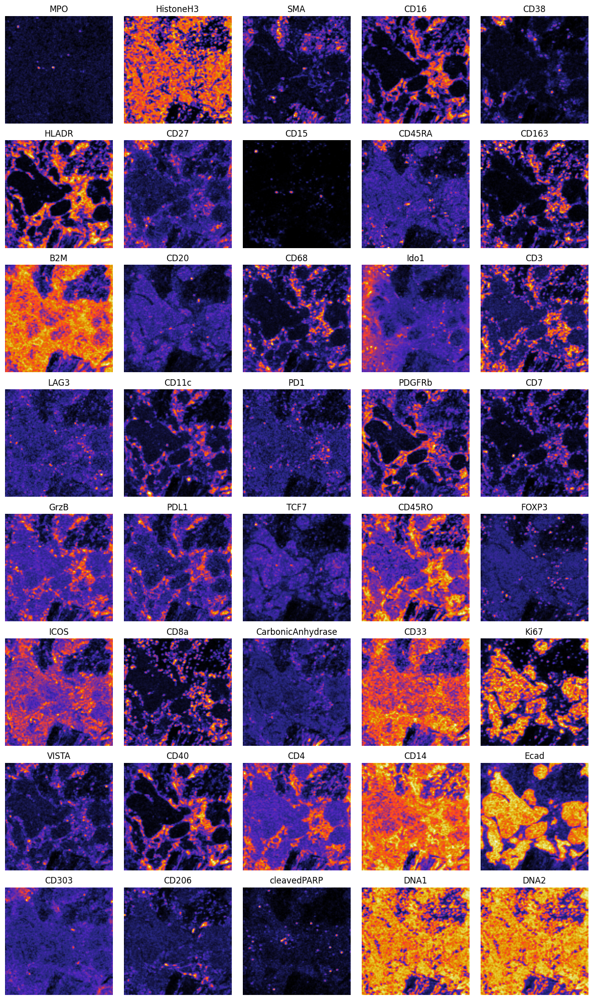

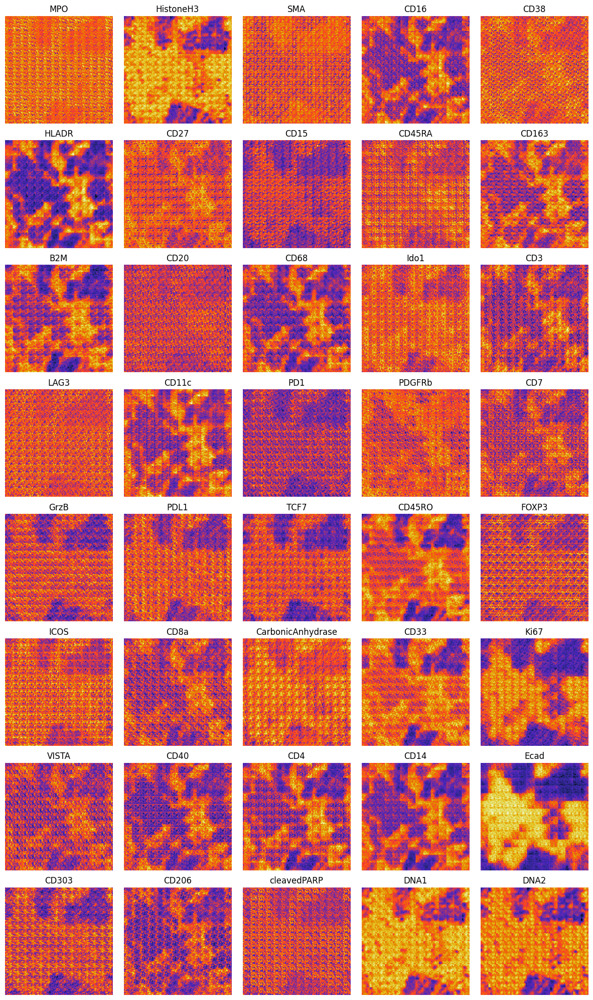

In [11]:
test_img, test_channel_ids = test_dataset[16]
test_img = test_img.to(torch.float32).to(device)
test_channel_ids = test_channel_ids.to(device)

test_img = test_img.unsqueeze(0)
test_channel_ids = test_channel_ids.unsqueeze(0)

with torch.no_grad():
    output, _ = model(test_img, test_channel_ids)

plot_markers(test_img.squeeze().cpu().numpy(), markers_names_map)
plot_markers(output.squeeze().cpu().numpy(), markers_names_map)

In [12]:
train(model, optimizer, train_dataloader, val_dataloader, device, epochs=epochs, gradient_accumulation_steps=gradient_accumulation_steps)

100%|██████████| 100/100 [00:51<00:00,  1.94it/s]


Epoch 0 loss: 0.0060936831403523685
Validation loss: 0.007375797983258963


100%|██████████| 100/100 [00:52<00:00,  1.92it/s]


Epoch 1 loss: 0.005893547716550529
Validation loss: 0.0076503830775618556


100%|██████████| 100/100 [00:51<00:00,  1.93it/s]


Epoch 2 loss: 0.005929162430111319
Validation loss: 0.007586116110906005


100%|██████████| 100/100 [00:51<00:00,  1.93it/s]


Epoch 3 loss: 0.0058034284855239095
Validation loss: 0.00802381495013833


100%|██████████| 100/100 [00:51<00:00,  1.93it/s]


Epoch 4 loss: 0.005544103342108428
Validation loss: 0.007029655566439033


100%|██████████| 100/100 [00:51<00:00,  1.93it/s]


Epoch 5 loss: 0.005614506986457855
Validation loss: 0.008034322261810303


100%|██████████| 100/100 [00:51<00:00,  1.94it/s]


Epoch 6 loss: 0.005621540157590061
Validation loss: 0.007716464372351766


100%|██████████| 100/100 [00:51<00:00,  1.94it/s]


Epoch 7 loss: 0.005333964785095304
Validation loss: 0.007761898711323738


100%|██████████| 100/100 [00:51<00:00,  1.94it/s]


Epoch 8 loss: 0.005183823530096561
Validation loss: 0.007761061796918512


100%|██████████| 100/100 [00:51<00:00,  1.94it/s]


Epoch 9 loss: 0.005030460683628917
Validation loss: 0.008641943726688623


100%|██████████| 100/100 [00:51<00:00,  1.94it/s]


Epoch 10 loss: 0.004977600695565343
Validation loss: 0.007489357898011803


100%|██████████| 100/100 [00:51<00:00,  1.94it/s]


Epoch 11 loss: 0.004744197300169617
Validation loss: 0.006975554116070271


100%|██████████| 100/100 [00:51<00:00,  1.94it/s]


Epoch 12 loss: 0.0048760463274084035
Validation loss: 0.007328105149790645


100%|██████████| 100/100 [00:51<00:00,  1.94it/s]


Epoch 13 loss: 0.004663003704044968
Validation loss: 0.007091351337730884


100%|██████████| 100/100 [00:51<00:00,  1.94it/s]


Epoch 14 loss: 0.004459105657879263
Validation loss: 0.0070083077438175675


100%|██████████| 100/100 [00:51<00:00,  1.94it/s]


Epoch 15 loss: 0.004489486031234264
Validation loss: 0.007026099869981408


100%|██████████| 100/100 [00:51<00:00,  1.94it/s]


Epoch 16 loss: 0.0046381857851520185
Validation loss: 0.007230069302022457


100%|██████████| 100/100 [00:52<00:00,  1.90it/s]


Epoch 17 loss: 0.00439416429027915
Validation loss: 0.006630893787369132


100%|██████████| 100/100 [00:52<00:00,  1.90it/s]


Epoch 18 loss: 0.004387824977748096
Validation loss: 0.0068699133954942225


100%|██████████| 100/100 [00:52<00:00,  1.91it/s]


Epoch 19 loss: 0.004145997888408601
Validation loss: 0.007208221154287458


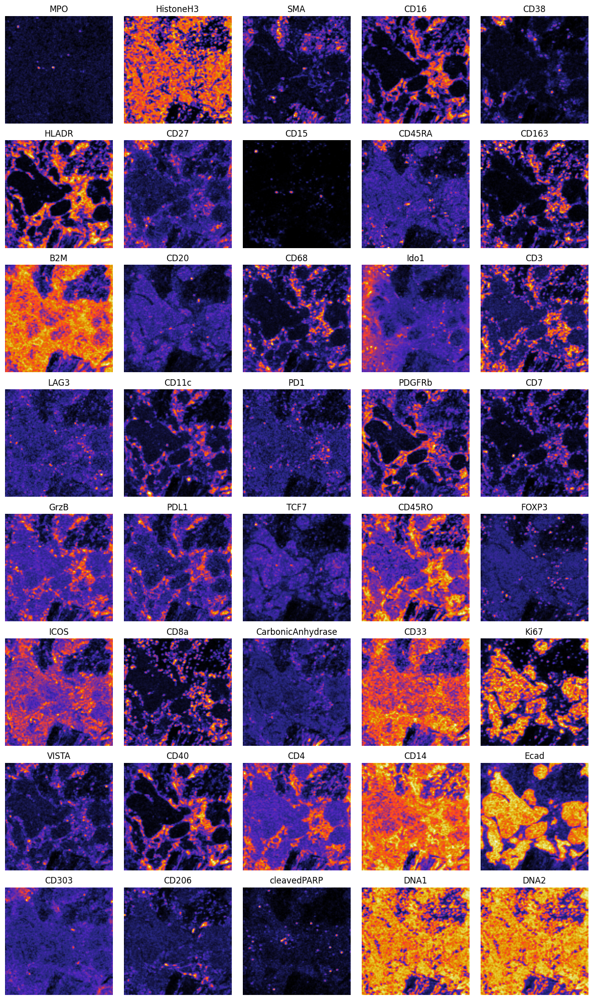

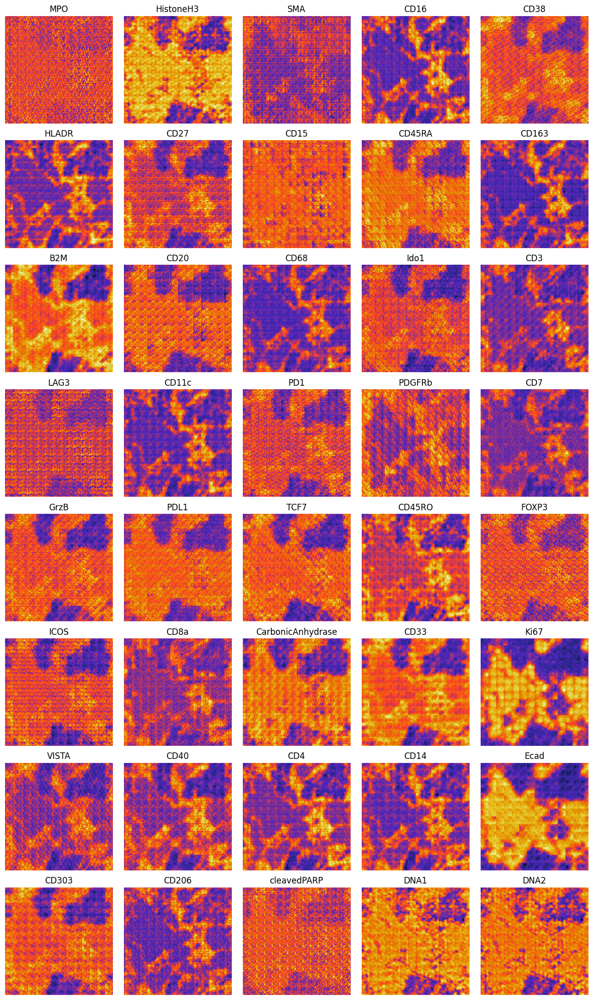

In [13]:
test_img, test_channel_ids = test_dataset[16]
test_img = test_img.to(torch.float32).to(device)
test_channel_ids = test_channel_ids.to(device)

test_img = test_img.unsqueeze(0)
test_channel_ids = test_channel_ids.unsqueeze(0)

with torch.no_grad():
    output, _ = model(test_img, test_channel_ids)

plot_markers(test_img.squeeze().cpu().numpy(), markers_names_map)
plot_markers(output.squeeze().cpu().numpy(), markers_names_map)

In [ ]:
torch.save(model.state_dict(), 'model_autoencoder_simpl_swin_hierarch.pth')

In [9]:
device = 'cuda' if torch.cuda.is_available() else 'mps'

encoder_layers_blocks = [3, 3, 3]
encoder_embedding_dims = [96, 192, 384]
encoder_num_heads = [6, 6, 6]
encoder_window_sizes = [28, 14, 0]

decoder_dim = 192
decoder_blocks_num = 3
decoder_num_heads = 6

# latent_dim = 384

model = MultiplexImageTransformer(
    channel_embedding_dim=96,
    num_channels=40,
    encoder_layers_blocks=encoder_layers_blocks,
    encoder_embedding_dims=encoder_embedding_dims,
    encoder_heads=encoder_num_heads,
    encoder_window_sizes=encoder_window_sizes,
    decoder_dim=decoder_dim,
    decoder_blocks_num=decoder_blocks_num,
    decoder_num_heads=decoder_num_heads
).to(device)

In [10]:
lr = 1e-4
weight_decay = 0.001
gradient_accumulation_steps = 1
epochs = 30
optimizer = optim.AdamW(model.parameters(), lr=lr, weight_decay=weight_decay)

train(model, optimizer, train_dataloader, val_dataloader, device, epochs=epochs, gradient_accumulation_steps=gradient_accumulation_steps)

  0%|          | 0/100 [00:00<?, ?it/s]

100%|██████████| 100/100 [00:54<00:00,  1.82it/s]


Epoch 0 loss: 0.026769774360582234
Validation loss: 0.011991677694022656


100%|██████████| 100/100 [00:53<00:00,  1.88it/s]


Epoch 1 loss: 0.012768768416717648
Validation loss: 0.010779284536838532


100%|██████████| 100/100 [00:53<00:00,  1.87it/s]


Epoch 2 loss: 0.012085937312804163
Validation loss: 0.010070227086544037


100%|██████████| 100/100 [00:53<00:00,  1.89it/s]


Epoch 3 loss: 0.011477267402224243
Validation loss: 0.009912413973361255


100%|██████████| 100/100 [00:53<00:00,  1.88it/s]


Epoch 4 loss: 0.011344113140366971
Validation loss: 0.009750204384326935


100%|██████████| 100/100 [00:53<00:00,  1.88it/s]


Epoch 5 loss: 0.01108924022410065
Validation loss: 0.009631298761814833


100%|██████████| 100/100 [00:52<00:00,  1.89it/s]


Epoch 6 loss: 0.010837538321502506
Validation loss: 0.00988231934607029


100%|██████████| 100/100 [00:53<00:00,  1.88it/s]


Epoch 7 loss: 0.010618367921561003
Validation loss: 0.009599713142961264


100%|██████████| 100/100 [00:53<00:00,  1.89it/s]


Epoch 8 loss: 0.010987959150224925
Validation loss: 0.009525149054825306


100%|██████████| 100/100 [00:52<00:00,  1.89it/s]


Epoch 9 loss: 0.010728756734170019
Validation loss: 0.010047254730015992


100%|██████████| 100/100 [00:53<00:00,  1.88it/s]


Epoch 10 loss: 0.010973131745122372
Validation loss: 0.009462381321936846


100%|██████████| 100/100 [00:53<00:00,  1.89it/s]


Epoch 11 loss: 0.010460307346656919
Validation loss: 0.009554818496108055


100%|██████████| 100/100 [00:53<00:00,  1.88it/s]


Epoch 12 loss: 0.010582624059170485
Validation loss: 0.009496426861733197


100%|██████████| 100/100 [00:53<00:00,  1.88it/s]


Epoch 13 loss: 0.01083529149647802
Validation loss: 0.009385027904063464


100%|██████████| 100/100 [00:53<00:00,  1.88it/s]


Epoch 14 loss: 0.010743581810966135
Validation loss: 0.009555712416768074


100%|██████████| 100/100 [00:53<00:00,  1.88it/s]


Epoch 15 loss: 0.010912169823423029
Validation loss: 0.009426928460597991


100%|██████████| 100/100 [00:53<00:00,  1.88it/s]


Epoch 16 loss: 0.010527661815285683
Validation loss: 0.009590842109173537


100%|██████████| 100/100 [00:53<00:00,  1.88it/s]


Epoch 17 loss: 0.010610497510060667
Validation loss: 0.009330680817365647


100%|██████████| 100/100 [00:53<00:00,  1.88it/s]


Epoch 18 loss: 0.010403434736654163
Validation loss: 0.009660496804863215


100%|██████████| 100/100 [00:53<00:00,  1.88it/s]


Epoch 19 loss: 0.010426247091963887
Validation loss: 0.009350367002189159


100%|██████████| 100/100 [00:53<00:00,  1.88it/s]


Epoch 20 loss: 0.010366336363367736
Validation loss: 0.009342691507190465


100%|██████████| 100/100 [00:53<00:00,  1.88it/s]


Epoch 21 loss: 0.01040869883261621
Validation loss: 0.00937940938398242


100%|██████████| 100/100 [00:53<00:00,  1.88it/s]


Epoch 22 loss: 0.010648783962242305
Validation loss: 0.00938684169203043


100%|██████████| 100/100 [00:52<00:00,  1.90it/s]


Epoch 23 loss: 0.010429037660360336
Validation loss: 0.00932794738560915


100%|██████████| 100/100 [00:52<00:00,  1.90it/s]


Epoch 24 loss: 0.010611191149801016
Validation loss: 0.009350623972713946


100%|██████████| 100/100 [00:52<00:00,  1.90it/s]


Epoch 25 loss: 0.010286804735660553
Validation loss: 0.009261494912207126


100%|██████████| 100/100 [00:52<00:00,  1.90it/s]


Epoch 26 loss: 0.010651319422759115
Validation loss: 0.009385829251259565


100%|██████████| 100/100 [00:52<00:00,  1.90it/s]


Epoch 27 loss: 0.010499082156457007
Validation loss: 0.009265559408813715


100%|██████████| 100/100 [00:52<00:00,  1.90it/s]


Epoch 28 loss: 0.010648333914577961
Validation loss: 0.00942501425743103


100%|██████████| 100/100 [00:52<00:00,  1.90it/s]


Epoch 29 loss: 0.010735068041831254
Validation loss: 0.009368236027657986


In [11]:
train(model, optimizer, train_dataloader, val_dataloader, device, epochs=epochs, gradient_accumulation_steps=gradient_accumulation_steps)

100%|██████████| 100/100 [00:52<00:00,  1.90it/s]


Epoch 0 loss: 0.010580113660544156
Validation loss: 0.009459348954260349


100%|██████████| 100/100 [00:52<00:00,  1.90it/s]


Epoch 1 loss: 0.010507818073965608
Validation loss: 0.009280790351331234


100%|██████████| 100/100 [00:52<00:00,  1.90it/s]


Epoch 2 loss: 0.010405032229609788
Validation loss: 0.009247815050184727


100%|██████████| 100/100 [00:52<00:00,  1.90it/s]


Epoch 3 loss: 0.010509957363829016
Validation loss: 0.009452464040368796


100%|██████████| 100/100 [00:52<00:00,  1.90it/s]


Epoch 4 loss: 0.010397865734994412
Validation loss: 0.009333899840712548


100%|██████████| 100/100 [00:52<00:00,  1.90it/s]


Epoch 5 loss: 0.010374819245189428
Validation loss: 0.009319286104291677


100%|██████████| 100/100 [00:52<00:00,  1.90it/s]


Epoch 6 loss: 0.010387217560783028
Validation loss: 0.009287628810852766


100%|██████████| 100/100 [00:52<00:00,  1.90it/s]


Epoch 7 loss: 0.010257909409701824
Validation loss: 0.009381962791085243


100%|██████████| 100/100 [00:52<00:00,  1.90it/s]


Epoch 8 loss: 0.01036556086037308
Validation loss: 0.00932887576520443


100%|██████████| 100/100 [00:52<00:00,  1.90it/s]


Epoch 9 loss: 0.010534062101505696
Validation loss: 0.009283776748925448


100%|██████████| 100/100 [00:52<00:00,  1.90it/s]


Epoch 10 loss: 0.010758011396974325
Validation loss: 0.009254165962338447


100%|██████████| 100/100 [00:52<00:00,  1.90it/s]


Epoch 11 loss: 0.010466466066427529
Validation loss: 0.00961894577369094


100%|██████████| 100/100 [00:52<00:00,  1.90it/s]


Epoch 12 loss: 0.010513877482153475
Validation loss: 0.009260503966361284


100%|██████████| 100/100 [00:52<00:00,  1.90it/s]


Epoch 13 loss: 0.01037229036912322
Validation loss: 0.009530078656971454


100%|██████████| 100/100 [00:52<00:00,  1.90it/s]


Epoch 14 loss: 0.01066115465015173
Validation loss: 0.00931269846856594


100%|██████████| 100/100 [00:52<00:00,  1.90it/s]


Epoch 15 loss: 0.010699989218264818
Validation loss: 0.009328550826758146


100%|██████████| 100/100 [00:52<00:00,  1.90it/s]


Epoch 16 loss: 0.010276038995943964
Validation loss: 0.00931084854528308


100%|██████████| 100/100 [00:52<00:00,  1.90it/s]


Epoch 17 loss: 0.010534853781573475
Validation loss: 0.009271270167082547


100%|██████████| 100/100 [00:52<00:00,  1.90it/s]


Epoch 18 loss: 0.01035863155964762
Validation loss: 0.009336216133087874


100%|██████████| 100/100 [00:52<00:00,  1.90it/s]


Epoch 19 loss: 0.010360586210153996
Validation loss: 0.0092933096177876


100%|██████████| 100/100 [00:52<00:00,  1.90it/s]


Epoch 20 loss: 0.010301076383329928
Validation loss: 0.009237693753093482


100%|██████████| 100/100 [00:52<00:00,  1.90it/s]


Epoch 21 loss: 0.010461224536411464
Validation loss: 0.009284042697399854


100%|██████████| 100/100 [00:52<00:00,  1.90it/s]


Epoch 22 loss: 0.010513561507686973
Validation loss: 0.009285509660840035


100%|██████████| 100/100 [00:52<00:00,  1.90it/s]


Epoch 23 loss: 0.010293817608617245
Validation loss: 0.009418021738529205


100%|██████████| 100/100 [00:52<00:00,  1.90it/s]


Epoch 24 loss: 0.01041052074637264
Validation loss: 0.009266062751412391


100%|██████████| 100/100 [00:52<00:00,  1.90it/s]


Epoch 25 loss: 0.010500206076540054
Validation loss: 0.00927537640556693


100%|██████████| 100/100 [00:52<00:00,  1.90it/s]


Epoch 26 loss: 0.010269216685555875
Validation loss: 0.009487512987107038


100%|██████████| 100/100 [00:52<00:00,  1.90it/s]


Epoch 27 loss: 0.010377240553498267
Validation loss: 0.009368348605930806


100%|██████████| 100/100 [00:52<00:00,  1.90it/s]


Epoch 28 loss: 0.01034594836179167
Validation loss: 0.009347410779446364


100%|██████████| 100/100 [00:52<00:00,  1.90it/s]


Epoch 29 loss: 0.010347555172629655
Validation loss: 0.009441612716764212


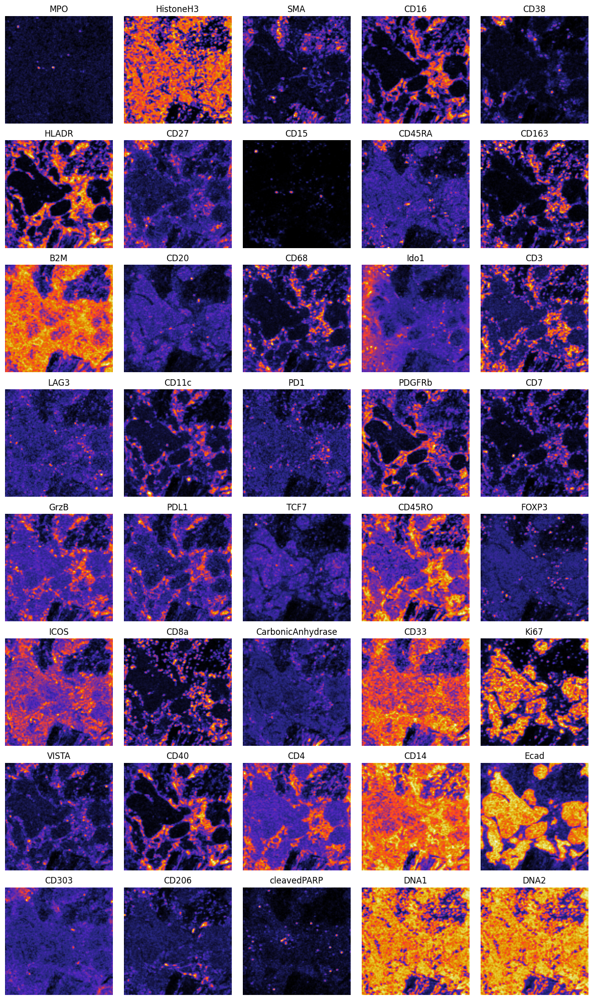

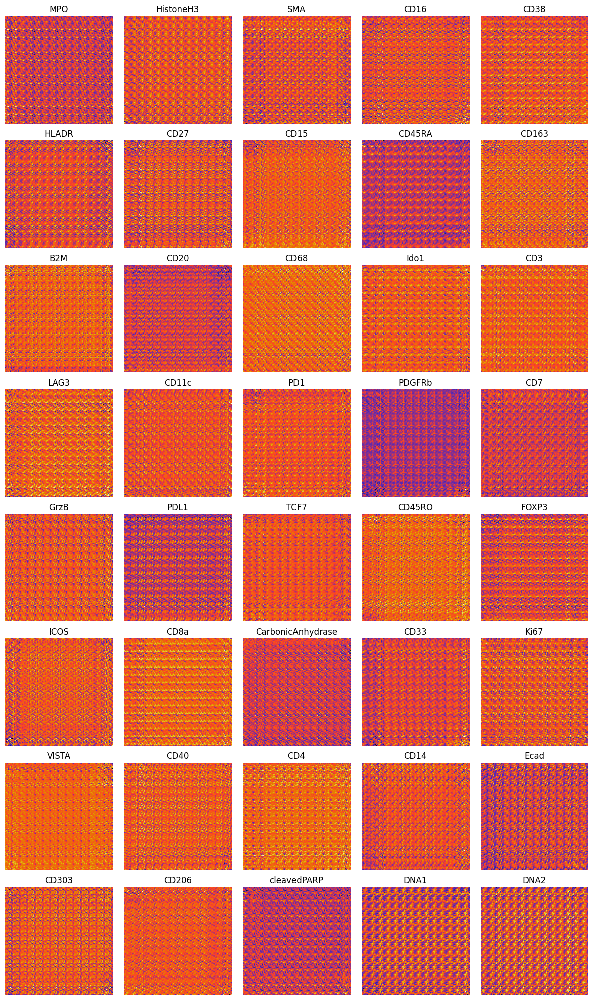

In [12]:
test_img, test_channel_ids = test_dataset[16]
test_img = test_img.to(torch.float32).to(device)
test_channel_ids = test_channel_ids.to(device)

test_img = test_img.unsqueeze(0)
test_channel_ids = test_channel_ids.unsqueeze(0)

with torch.no_grad():
    output, _ = model(test_img, test_channel_ids)

plot_markers(test_img.squeeze().cpu().numpy(), markers_names_map)
plot_markers(output.squeeze().cpu().numpy(), markers_names_map)